In [4]:
import os
from collections import defaultdict

import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import wandb
from helpers.generate_dataclass import SegmentationDataset
from helpers.plottingaftertraining import plot_samples_binary
from helpers.testing import test_binary
from helpers.training import train_binary
from helpers.validating import validation_binary
from PIL import Image
from torch.utils.data import DataLoader

In [5]:
torch.manual_seed(0)
np.random.seed(0)

# EDA

Im ersten Teil werde ich die Datenanalyse durchführen. Ich werde dabei die Bilder visuell und qualitativ untersuchen. Zuerst führe ich die Untersuchung auf den originalen Bildern durch. Danach werde ich sie mittels Dataloader einlesen und einerseits untersuchen, ob dabei Fehler passieren und danach untersuche ich die Bilder vertieft.

## Anzahl vorhandener Bilder

In [3]:
def count_images(folder):
    return len([name for name in os.listdir(folder)])

train_count = count_images('data/train/images')
test_count = count_images('data/test/images')
validation_count = count_images('data/validation/images')

print("Anzahl der Bilder in Train:", train_count)
print("Anzahl der Bilder in Test:", test_count)
print("Anzahl der Bilder in Validation:", validation_count)

Anzahl der Bilder in Train: 1385
Anzahl der Bilder in Test: 199
Anzahl der Bilder in Validation: 396


Im meinem Datensatz sind 1'385 Trainingsbilder, 200 Testbilder und 400 Bilder für die Verifikation vorhanden. Es sollten sich also um genügend Bilder handeln, um ein gutes Training durchzuführen. Der Train/Test Split ist mit 0.87 zwar relativ hoch, doch kann ich am Ende des Trainings zusätzlich die Verifikation Bilder als Test vom Modell verwenden.

## Inspektion der Bilder vor einlesen

Folgend stelle ich zehn Bilder und deren Masken vor, wie sie in der originalen Version vorhanden sind.

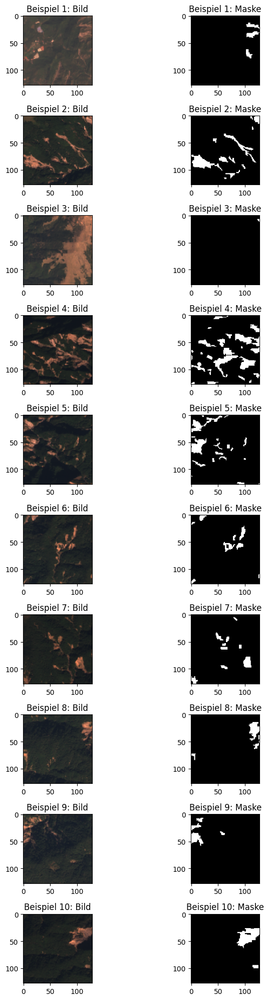

In [4]:
image_dir = 'data/train/images/'
mask_dir = 'data/train/masks/'

image_files = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.png')])
mask_files = sorted([os.path.join(mask_dir, f) for f in os.listdir(mask_dir) if f.endswith('.png')])

assert len(image_files) == len(mask_files)

fig, axs = plt.subplots(10, 2, figsize=(8, 20))

for i in range(10):
    # Bild
    image = Image.open(image_files[i])
    axs[i, 0].imshow(image)
    axs[i, 0].set_title(f'Beispiel {i + 1}: Bild')

    # Maske
    mask = Image.open(mask_files[i])
    axs[i, 1].imshow(mask, cmap="gray")
    axs[i, 1].set_title(f'Beispiel {i + 1}: Maske')

plt.tight_layout()
plt.show()

Erkennbar ist grösstenteils bewaldetes Terrain. Dies ist neben der grünen Farbe auch leicht an der Wölbungen der Baumkronen erkennbar. Daneben fallen hellbraune Flecken auf, die versplittert über die Bilder verteilt sind. Anhand der Masken wird ersichtlich, dass es sich hierbei grösstenteils um die gesuchten Erdrutsche handelt. Diese kommen sehr unterschiedlich (in Bezug auf Form, Grösse und Häufigkeit), aber in jedem der angeschauten Bilder vor. Allerdings ist die Farbe keine Garantie, dass es sich um einen Erdrutsch handelt. Ich vermute, dass die restlichen braunen Formen, meistens schlangenförmig, Bäche oder Strassen sind. In weiteren angeschauten Bildern treten Bäche und Flüsse häufig auf und können einfach mit Erdrutschen verwechselt werden. Weiter sind die Wälder meistens relativ dunkel.

Die Masken selber scheinen nur aus zwei Farben, schwarz und weiss zu bestehen. Gemäss der Dokumentation der Challenge steht Klasse 0 (was der Farbe Schwarz entspricht), für Hintergrund und Klasse 1 (weiss) für Erdrutsche. Es wird auch ersichtlich, dass meistens deutlich mehr Hintergrund vorhanden ist.

## Überprüfung der Klassen in den Train Masken

Folgend untersuche die Farbmodi der Bilder und eine weitere Idee der Daten und notwendigen Aufbereitung zu erhalten. Gemäss Lones untersuche ich nicht alle Daten, sondern beschränke mich auf die Trainingsbilder, die rund 70% des Datensatzes ausmachen.

In [5]:
mode_counter_images = {}

for image_file in image_files:
    image_mode = Image.open(image_file).mode
    if image_mode in mode_counter_images:
        mode_counter_images[image_mode] += 1
    else:
        mode_counter_images[image_mode] = 1

print("Bilder: ", mode_counter_images)

mode_counter_masks = {}

for mask_file  in mask_files:
    mask_mode = Image.open(mask_file ).mode
    if mask_mode in mode_counter_masks:
        mode_counter_masks[mask_mode] += 1
    else:
        mode_counter_masks[mask_mode] = 1

print("Masken: ", mode_counter_masks)

Bilder:  {'RGBA': 1385}
Masken:  {'RGBA': 1385}


Sämtliche Bilder und Masken sind im Modus RGBA enthalten. Damit sollten keine speziellen Hürden bei dem Einlesen entstehen.

Folgend untersuche ich die Annahme, dass in den Masken nur zwei Klassen enthalten sind.

In [6]:
unique_values = set()

for mask_path in mask_files:
    mask = Image.open(mask_path)
    
    values = np.unique(np.array(mask))
    unique_values.update(values)

print("Anzahl unterschiedlicher Klassen/Farbtöne: ", len(unique_values))
print("Die unterschiedlichen Klassen/Farbtöne: ", values)

Anzahl unterschiedlicher Klassen/Farbtöne:  2
Die unterschiedlichen Klassen/Farbtöne:  [  0 255]


Wie erwähnt sind gemäss Dokumentation in den Masken nur zwei Klassen vorhanden. Farbton 0 entspricht, wie bei der visuellen Inspektion gesehen, der Klasse 0 und Farbton 255 den Erdrutschen. Ich werde diese Daten also in binär 0/1 umwandeln können.

## Überprüfung der unterschiedlichen Bildgrössen im Traindatensatz

Unterschiedliche Grössen der Bilder können das Training von Modellen erschweren. Ich werde deshalb auch diese Daten untersuchen.

In [7]:
unique_image_sizes = set()
unique_mask_sizes = set()

for image_file in image_files:
    with Image.open(image_file) as img:
        unique_image_sizes.add(img.size)

for mask_file in mask_files:
    with Image.open(mask_file) as mask:
        unique_mask_sizes.add(mask.size)

print("Einzigartige Bildgrößen:", unique_image_sizes)
print("Einzigartige Maskengrößen:", unique_mask_sizes)

Einzigartige Bildgrößen: {(128, 128)}
Einzigartige Maskengrößen: {(128, 128)}


Sämtliche Bilder und Masken haben die Grösse 128 x 128. Ich werde vorerst keinen Resize einbauen müssen. Höchstens wenn später fremde Bilder, die nicht in dem Datensatz vorhanden sind und entsprechend aufbereitet wurden, untersucht werden wollen, muss ein Resize berücksichtigt werden.

## Einlesen der Bilder für EDA

Nun werde ich die Daten in das Format, das für das Training notwendig ist, einlesen. Esi st wichtig, diese Bilder nochmals visuell zu untersuchen, da Transformationen durchgeführt werden und ich sicherstellen möchte, dass diese korrekt funktionieren. Im folgenden Beispiel werde ich die Daten aber nur in einen Tensor umwandeln, da ich die Bilder später auch qualitativ untersuche. Dabei sollen Transformationen wie Normalisierung die Resultate nicht verfälschen.

In [6]:
eda_train_data = SegmentationDataset(root='data', split='train', transform_mode='to_tensor')
eda_train_loader = DataLoader(eda_train_data, batch_size=64, shuffle=True)

## Inspektion der Bilder nach einlesen

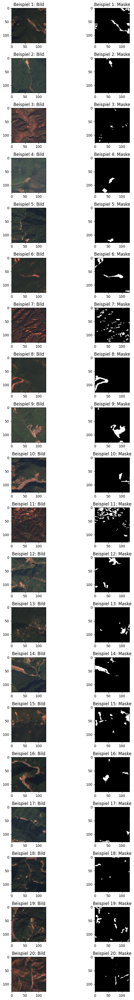

In [9]:
images, masks = next(iter(eda_train_loader))

fig, axs = plt.subplots(20, 2, figsize=(8, 40))  # 10 Reihen, 2 Spalten

for i in range(20):
    # Bild
    image = images[i].numpy().transpose((1, 2, 0))
    axs[i, 0].imshow(image)
    axs[i, 0].set_title(f'Beispiel {i + 1}: Bild')

    # Maske
    mask = masks[i][0].numpy()  # Beachte, dass wir nur den ersten Kanal für die Maske benötigen
    axs[i, 1].imshow(mask, cmap="gray")
    axs[i, 1].set_title(f'Beispiel {i + 1}: Maske')

plt.tight_layout()
plt.show()

Im Vergleich zu den zuvor angeschauten Bildern fällt mir die grössere Bandbreite an Farben und Helligkeiten bei den Bildern auf. Ersichtlich werden auch die erwähnten Flüsse, die ich teilweise mit Erdrutschen verwechselt habe. Insgesamt stimmen die Bilder (und der Qualität) weiterhin und die Masken entsprechen den dazugehörenden Bildern.

Ich habe auch die beiden Transformations-Methoden "normalize" und "flip" (inkl. Normierung) untersucht und konnte keine Probleme feststellen. Das Einlesen der Bilder funktioniert also wie gewünscht.

## Überprüfung der Bildergrössen

Ich bestätigte kurz, dass die Bilder weiterhin die gleiche Grösse aufweisen.

In [10]:
print("Grösser der Bilder:", images.shape)
print("Grösse der Masken:", masks.shape)

Grösser der Bilder: torch.Size([64, 3, 128, 128])
Grösse der Masken: torch.Size([64, 1, 128, 128])


Wie erwartet sind die Bilder weiterhin 128 x 128 gross. Der Wert 64 entspricht der gewünschten Batchsize, dieser Test ist ebenfalls positiv.

## Überprüfung der Klassen in den Train Masken

In [11]:
unique_values = set()

for images, masks in eda_train_loader:
    for mask in masks:
        values = np.unique(mask.numpy())
        unique_values.update(values)

print("Anzahl unterschiedlicher Klassen/Farbtöne: ", len(unique_values))
print("Die unterschiedlichen Klassen/Farbtöne: ", values)

Anzahl unterschiedlicher Klassen/Farbtöne:  2
Die unterschiedlichen Klassen/Farbtöne:  [0. 1.]


Wie ich bei den Originalen festgestellt habe, sind in den masken nur zwei Klassen vorhanden. Ich habe sie nun in die binären Werte 0/1 umgewandelt. Bei den Masken handelt es sich also nicht mehr um Bilder im grayscale, sondern sind binär.

## Verteilung der Klassen in den Train Masken
Das Verhältnis zwischen den Klassen kann im Deep Learning wichtig sein, weil Imbalance das Training und die Interpretation von Metriken erschweren kann.
In der folgenden Zelle untersuche ich das Verhältnis der beiden Klassen in den Trainingbildern.

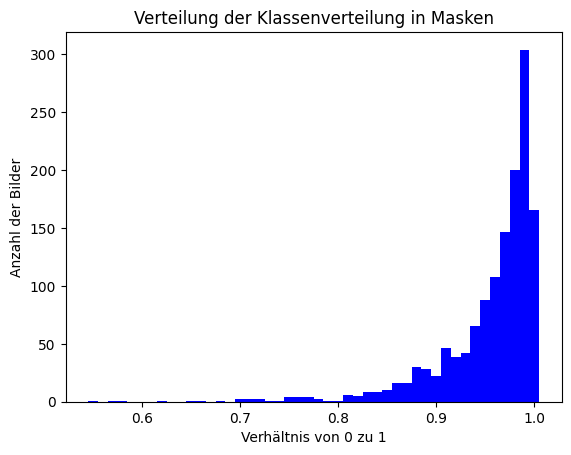

In [12]:
# Code mit ChatGPT erstellt

# Initialisieren Sie den Zähler
ratio_counter = defaultdict(int)

# Berechnen Sie das Verhältnis von 0 zu 1 für jedes Bild
for _, masks in eda_train_loader:
    for mask in masks:
        total_pixels = mask.numel()
        count_1 = torch.sum(mask).item()
        count_0 = total_pixels - count_1
        ratio = round(count_0 / (count_0 + count_1), 2)  # Rundet das Verhältnis auf zwei Dezimalstellen
        ratio_counter[ratio] += 1

# Erstellen Sie ein Histogramm mit matplotlib
ratios = list(ratio_counter.keys())
counts = [ratio_counter[ratio] for ratio in ratios]

plt.bar(ratios, counts, width=0.01, color='blue')
plt.xlabel('Verhältnis von 0 zu 1')
plt.ylabel('Anzahl der Bilder')
plt.title('Verteilung der Klassenverteilung in Masken')
plt.show()

Das Histogramm zeigt auf, dass die Klassen sehr ungleichmässig verteilt sind. Die x-Achse entspricht dem Anteil Hintergrund zu Erdrutschen. Ein x-Wert von 0.9 entspricht 90% Hintergrund und 10% Erdrutsch. Die Verteilung zeigt, dass die meisten Bilder ein Verhältnis von über 0.9 aufweisen. Dies entspricht der visuellen Erkenntnis, dass viel mehr Hintergrund vorhanden ist.

Dies bedeutet, dass eine starke Imbalance vorhanden ist. Im Fall dieser Challenge gilt der F1 Score der Erdrutsche als Zielmetrik. Das ist vor dem Hintergrund der Imbalance eine gute Lösung, dass nur die Prognosen der untervertretenen Klasse berücksichtigt wird.

## Verteilung der Farben in den Train Bildern

Die Farben und deren Verteilung geben ein qualitatives Verständnis der Bilder. Es kann herausgefunden werden, ob Bilder zum Beispiel über- oder unterbelichtet sind oder ob einzelne Farben anders häufig vertreten sind.

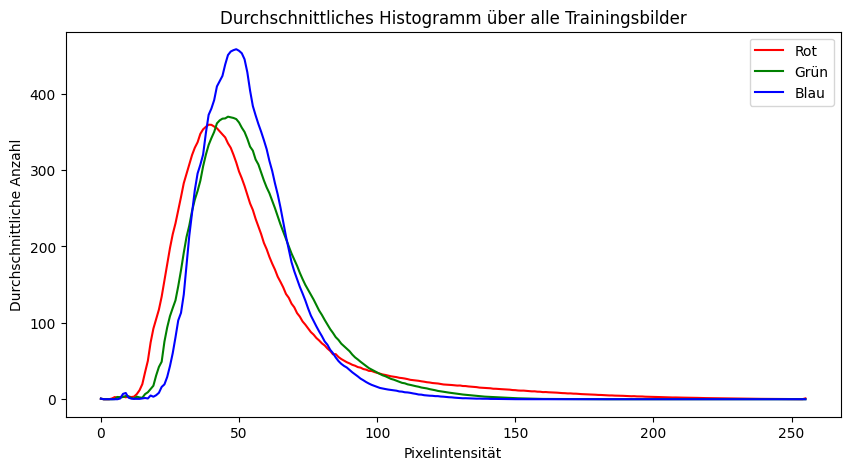

In [13]:
# Code mit ChatGPT erstellt

# Initialisiere Histogramm-Arrays
histogram_red = np.zeros(256)
histogram_green = np.zeros(256)
histogram_blue = np.zeros(256)

for images, _ in eda_train_loader:
    # Versichern Sie sich, dass die Bilder auf der CPU liegen (falls sie auf GPU geladen werden)
    images = images.cpu().numpy()
    
    # Die Form von `images` ist [batch_size, channels, height, width]
    for i in range(images.shape[0]):
        histogram_red += np.histogram(images[i, 0].flatten(), bins=256, range=(0, 1))[0]
        histogram_green += np.histogram(images[i, 1].flatten(), bins=256, range=(0, 1))[0]
        histogram_blue += np.histogram(images[i, 2].flatten(), bins=256, range=(0, 1))[0]

# Mitteln Sie die Histogramme über alle Bilder
num_images = len(eda_train_loader.dataset)
histogram_red /= num_images
histogram_green /= num_images
histogram_blue /= num_images

# Plotte die Histogramme
plt.figure(figsize=(10, 5))
plt.title("Durchschnittliches Histogramm über alle Trainingsbilder")
plt.xlabel("Pixelintensität")
plt.ylabel("Durchschnittliche Anzahl")
plt.plot(histogram_red, color='red', label='Rot')
plt.plot(histogram_green, color='green', label='Grün')
plt.plot(histogram_blue, color='blue', label='Blau')
plt.legend()
plt.show()

Die drei Farben kommen in etwa gleich häufig vor. Mit einem Wert um 50 ist die Intensität aber eher tief. Dies ist auch in den Bildern ersichtlich, wo der Wald häufig dunkel ist.

## Signal to Noise

Signal to Noise ist eine Metrik, die in unterschiedlichen [Usecases](https://spie.org/news/3421-enhancing-space-based-signal-to-noise-ratios-without-redesigning-the-satellite?SSO=1) im Bereich Signal und Bild zur Anwendung kommt. Sie liefert eine Kennzahl zur Bildqualität und misst das Signal im Verhältnis zum Noise.

In [14]:
def calculate_snr(image):
    mean_value = np.mean(image)
    std_deviation = np.std(image)
    return mean_value / std_deviation

snr_values = []

for images, _ in eda_train_loader:
    for image in images:
        img = (image.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
        snr = calculate_snr(img)
        snr_values.append(snr)

# Statistiken für das SNR berechnen:
average_snr = np.mean(snr_values)
max_snr = np.max(snr_values)
min_snr = np.min(snr_values)

print("Durchschnittliches SNR:", round(average_snr, 2))
print("Maximales SNR:", round(max_snr, 2))
print("Minimales SNR:", round(min_snr, 2))

Durchschnittliches SNR: 3.14
Maximales SNR: 9.72
Minimales SNR: 1.27


Ich habe kaum Angaben für ideale Werte für Bilder gefunden, laut [Wikipedia](https://en.wikipedia.org/wiki/Signal-to-noise_ratio_(imaging)) ist aber ein Verhältnis von 10 ein akzeptabler Wert. Mit einem durchschnittlichen SNR von 3.14 sind meine Bilder allerdings deutlich darunter und weisen eine hohe Schwankung auf. Dass die Bilder nicht von sehr hoher Qualität sind, habe ich bei der visuellen Inspektion gesehen, der Wert scheint aber doch sehr tief zu sein. Ich gehe  nicht davon aus, dass ich ihn mit den klassichen Data Augmentation Verfahren von Pytorch merklich verbessern kann.

## Untersuchung des Kontrasts

Für die Berechnung des Kontrasts verwende ich die [RMS contrast](https://en.wikipedia.org/wiki/Contrast_(vision)#RMS_contrast) Methode. Der Kontrast sagt aus, wie stark sich die hellen und dunklen Bereiche eines Bildes unterscheiden.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Durchschnittlicher Kontrast: 14.27
Maximaler Kontrast: 38.45
Minimaler Kontrast: 2.81


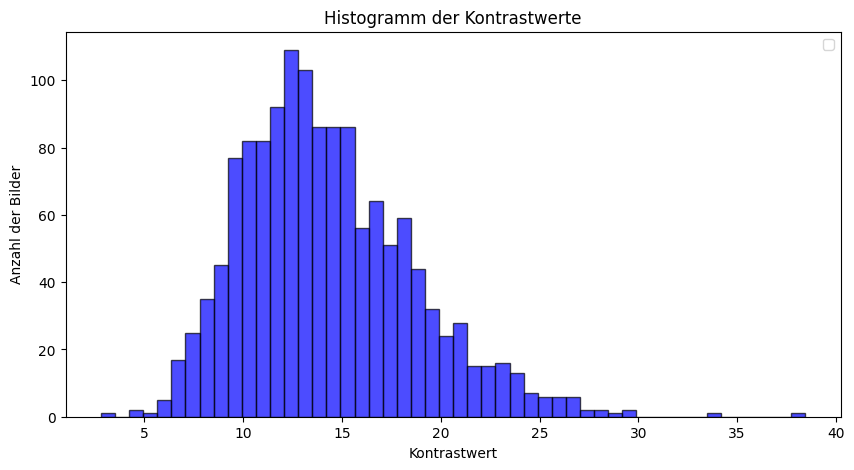

In [15]:
def calculate_contrast(image):
    # Konvertieren Sie das Bild in Graustufen für die Kontrastanalyse
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Der Kontrast ist die Standardabweichung der Pixelwerte
    return np.std(gray)

contrast_values = []

for images, _ in eda_train_loader:
    for image in images:
        img = (image.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
        contrast = calculate_contrast(img)
        contrast_values.append(contrast)

# Statistiken für den Kontrast berechnen
average_contrast = np.mean(contrast_values)
max_contrast = np.max(contrast_values)
min_contrast = np.min(contrast_values)

print("Durchschnittlicher Kontrast:", round(average_contrast, 2))
print("Maximaler Kontrast:", round(max_contrast, 2))
print("Minimaler Kontrast:", round(min_contrast, 2))

# Plotte die Histogramme
plt.figure(figsize=(10, 5))
plt.hist(contrast_values, bins=50, color='blue', edgecolor='black', alpha=0.7)
plt.title("Histogramm der Kontrastwerte")
plt.xlabel("Kontrastwert")
plt.ylabel("Anzahl der Bilder")
plt.legend()
plt.show()

Auch hier ist es schwierig, einen idealen Wert zu finden. Wichtig ist aus meiner Sicht, dass die Bandbreite wieder sehr hoch ist. Im Histogramm wird ersichtlich, dass die meisten Werte zwischen 10 und 20 liegen.

## Untersuchung der Komponenten

Nun werde ich die Erdrutsche untersuchen. Ich versuche herauszufinden, ob es Unterschiede zum restlichen Bild gibt.

Im ersten Schritt probiere ich die Funktionsweise von cv2.connectedComponentsWithStats aus und plotte für ein Bild die gefundenen Komponenten. Ich verwende dafür die Masken, weil dort die Komponenten entweder Hintergrund oder Erdrütsche sein müssen.

Anzahl Komponenten:  2
Grösse der Komponenten:  [15749   635]


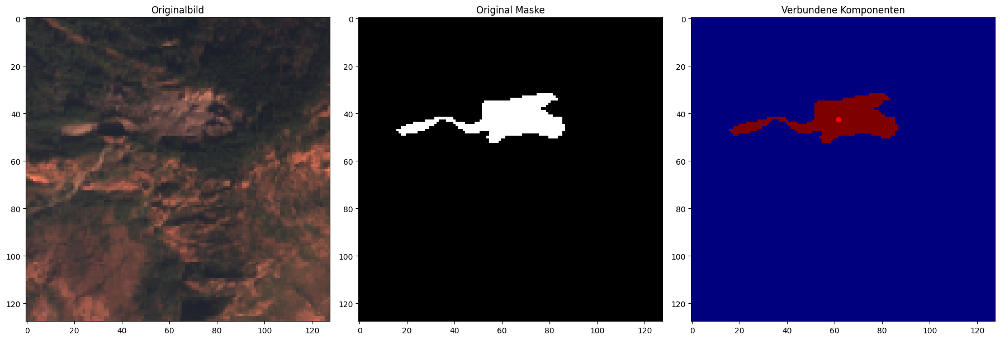

In [16]:

# Ihr bestehender Code
images, masks = next(iter(eda_train_loader))

# Bild und Maske extrahieren
image = images[0].numpy().transpose(1, 2, 0)  # (C, H, W) zu (H, W, C)
mask = masks[0].numpy().squeeze(0)
if mask.dtype != np.uint8:
    mask = mask.astype(np.uint8)

num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(mask)
print("Anzahl Komponenten: ", num_labels)
print("Grösse der Komponenten: ", stats[:, cv2.CC_STAT_AREA])

# Visualisierung
fig, ax = plt.subplots(1, 3, figsize=(18, 6))

# Originalbild anzeigen
ax[0].imshow(image)  
ax[0].set_title("Originalbild")

# Originalmaske anzeigen
ax[1].imshow(mask, cmap="gray")
ax[1].set_title("Original Maske")

# Labels anzeigen
ax[2].imshow(labels, cmap="jet")
ax[2].set_title("Verbundene Komponenten")

# optional: Zentroide hinzufügen
for c in centroids[1:]:  
    ax[2].plot(c[0], c[1], 'ro')  

plt.tight_layout()
plt.show()

Dieser Plot zeigt, dass mit der gewählten Funktion auf Masken gut die Erdrutsche erkannt werden. Ich erhalte weiter die Anzahl die Anzahl der gefundenen Komponenten und die Pixelgrösse. Da der Hintergrund auch als Komponente gezählt wird, muss die Anzahl um 1 reduziert werden und die Grösse der ersten Komponente kann ignoriert werden.

Nun zähle ich die Anzahl Komponenten und stelle sie ins Verhältnis.

In [17]:
n_komponenten = 0
size_komponenten = 0
n_masks = 0

for images, masks in eda_train_loader:
    for maske in masks:
        mask = maske.numpy().squeeze(0).astype(np.uint8)

        num_labels, _, stats, _ = cv2.connectedComponentsWithStats(mask)
        
        n_komponenten += (num_labels - 1)
        size_komponenten += np.sum(stats[1:, cv2.CC_STAT_AREA])
    
    n_masks += len(masks)

mean_components = n_komponenten / n_masks
mean_size = size_komponenten / n_komponenten 

print("Durchschnittliche Anzahl von Komponenten pro Bild:", round(mean_components, 2))
print("Durchschnittliche Grösse der Komponenten in Pixel:", round(mean_size, 2))

Durchschnittliche Anzahl von Komponenten pro Bild: 6.77
Durchschnittliche Grösse der Komponenten in Pixel: 108.83


Über alle Trainingbilder kommen durchschnittlich 6.8 Komponenten (resp. Erdrutsch) vor und sie haben eine gemittelte Grösse von 109 Pixel.

Die Grösse ist im Verhältnis zum gesamten Bilder (16'384 Pixel) sehr klein. Dies bestätigt die visuelle Erkenntnis.

In [18]:
print("Anzahl Pixel pro Maske:", mask.shape[0] * mask.shape[1])

Anzahl Pixel pro Maske: 16384


Ich untersuche nun die Verteilung der Grösse der Erdrutsche.

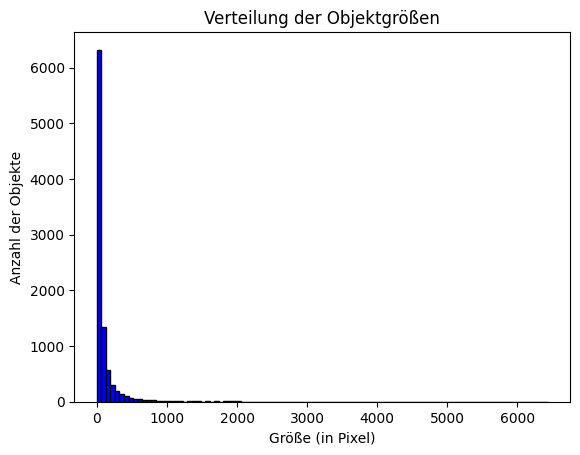

In [19]:
# Liste, um die Größen aller gefundenen Komponenten zu speichern
component_sizes = []

for _, masks in eda_train_loader:
    for mask in masks:
        # Umwandeln des Tensors in ein Numpy-Array
        mask_np = mask.squeeze(0).numpy().astype(np.uint8)

        # Finde die verbundenen Komponenten und ihre Statistiken
        _, _, stats, _ = cv2.connectedComponentsWithStats(mask_np, connectivity=8)

        # Extrahiere die Größen der gefundenen Komponenten (ignoriere den Hintergrund)
        for i, stat in enumerate(stats):
            if i != 0:  # Hintergrund ignorieren
                component_sizes.append(stat[cv2.CC_STAT_AREA])

# Erstelle ein Histogramm der Komponentengrößen
plt.hist(component_sizes, bins=100, color='blue', edgecolor='black')
plt.title('Verteilung der Objektgrößen')
plt.xlabel('Größe (in Pixel)')
plt.ylabel('Anzahl der Objekte')
plt.show()

Dieses Histogramm zeigt, dass die allermeisten Komponenten sehr klein sind. Es gibt kaum Ausreisser mit einer grösse über 300 Pixel. Dies bestätigt auch die zuvor gemachte Untersuchung der Verhältnisse zwischen Hintergrund und Erdrutsche.

## Verteilung der Farben der Komponenten

Aufgrund der visuellen Inspektion vermute ich, dass die Erdrutsche andere Farbmuster aufweisen.

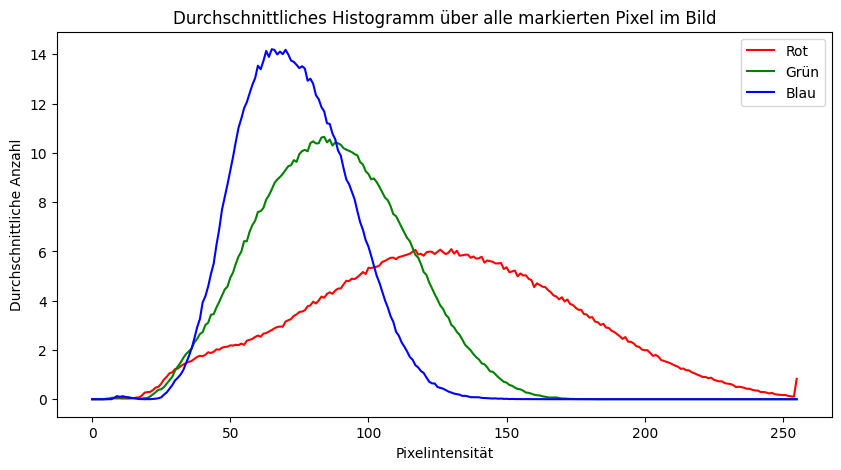

In [20]:
# Initialisiere Histogramm-Arrays
histogram_red = np.zeros(256)
histogram_green = np.zeros(256)
histogram_blue = np.zeros(256)

component_count = 0

for images, masks in eda_train_loader:
    # Versichern Sie sich, dass die Bilder auf der CPU liegen (falls sie auf GPU geladen werden)
    images = images.cpu().numpy()

    for idx, mask in enumerate(masks):
        # Umwandeln des Tensors in ein Numpy-Array
        mask_np = mask.squeeze(0).numpy().astype(np.uint8)
        
        # Erhalte nur die Pixel, die den Wert 1 in der Maske haben
        component_mask = (mask_np == 1)

        # Wenn es Pixel in der Komponentenmaske gibt, führe die Analyse durch
        if np.any(component_mask):
            component_count += 1

            # Extrahieren der Pixelwerte des Bildes, die innerhalb der Maske liegen
            red_values = images[idx, 0][component_mask].flatten()
            green_values = images[idx, 1][component_mask].flatten()
            blue_values = images[idx, 2][component_mask].flatten()

            # Aktualisieren der Histogramme für jeden Kanal
            histogram_red += np.histogram(red_values, bins=256, range=(0, 1))[0]
            histogram_green += np.histogram(green_values, bins=256, range=(0, 1))[0]
            histogram_blue += np.histogram(blue_values, bins=256, range=(0, 1))[0]

# Mitteln Sie die Histogramme über alle Komponenten
histogram_red /= component_count
histogram_green /= component_count
histogram_blue /= component_count

# Plotte die Histogramme
plt.figure(figsize=(10, 5))
plt.title("Durchschnittliches Histogramm über alle markierten Pixel im Bild")
plt.xlabel("Pixelintensität")
plt.ylabel("Durchschnittliche Anzahl")
plt.plot(histogram_red, color='red', label='Rot')
plt.plot(histogram_green, color='green', label='Grün')
plt.plot(histogram_blue, color='blue', label='Blau')
plt.legend()
plt.show()

Das Histogramm der Trainingsbilder bestätigt, dass die Farben der Erdrutsche anders sind. Insbesondere die Farbe Rot weist einen höheren Mittelwert und Streuung auf. Auch die Farben Blau und Grün weisen einen höheren Mittelwert auf. Die Erdrutsche sind also heller und weisen einen höheren rot-Stich aus, was in der visuellen Inspektion erkennbar war.

## Untersuchung der Bildschärfe

Folgend untersuche ich die Unschärfe der Erdrutsche und vergleiche sie mit der Unschärfe der gesamten Bilder. Ich verwende dafür die [variance of the Laplacian](https://pyimagesearch.com/2015/09/07/blur-detection-with-opencv/) Methode.

In [21]:
def estimate_blur(image, mask):
    # Nur Pixel auswählen, die in der Maske den Wert 1 haben
    masked_image = cv2.bitwise_and(image, image, mask=mask)
    gray = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    fm = cv2.Laplacian(gray, cv2.CV_64F).var()
    return fm

blur_scores_masked = []

for images, masks in eda_train_loader:
    for idx, image in enumerate(images):
        img = (image.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
        mask = masks[idx].squeeze(0).numpy().astype(np.uint8) * 255  # Maske auf den Wertebereich [0, 255] skalieren
        blur_score = estimate_blur(img, mask)
        blur_scores_masked.append(blur_score)

# Statistiken für die Unschärfe berechnen:
average_blur = np.mean(blur_scores_masked)
max_blur = np.max(blur_scores_masked)
min_blur = np.min(blur_scores_masked)

print("Durchschnittliche Unschärfe in der Maske:", round(average_blur, 2))
print("Maximale Unschärfe in der Maske:", round(max_blur, 2))
print("Minimale Unschärfe in der Maske:", round(min_blur, 2))

Durchschnittliche Unschärfe in der Maske: 464.4
Maximale Unschärfe in der Maske: 3034.71
Minimale Unschärfe in der Maske: 0.0


In [22]:
def estimate_blur(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    fm = cv2.Laplacian(gray, cv2.CV_64F).var()
    return fm

blur_scores_whole = []

for images, _ in eda_train_loader:
    for image in images:
        img = (image.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
        blur_score = estimate_blur(img)
        blur_scores_whole.append(blur_score)

# Statistiken für die Unschärfe berechnen:
average_blur = np.mean(blur_scores_whole)
max_blur = np.max(blur_scores_whole)
min_blur = np.min(blur_scores_whole)

print("Durchschnittliche Unschärfe im gesamten Bild:", round(average_blur, 2))
print("Maximale Unschärfe im gesamten Bild:", round(max_blur, 2))
print("Minimale Unschärfe im gesamten Bild:", round(min_blur, 2))

Durchschnittliche Unschärfe im gesamten Bild: 159.17
Maximale Unschärfe im gesamten Bild: 573.14
Minimale Unschärfe im gesamten Bild: 11.67


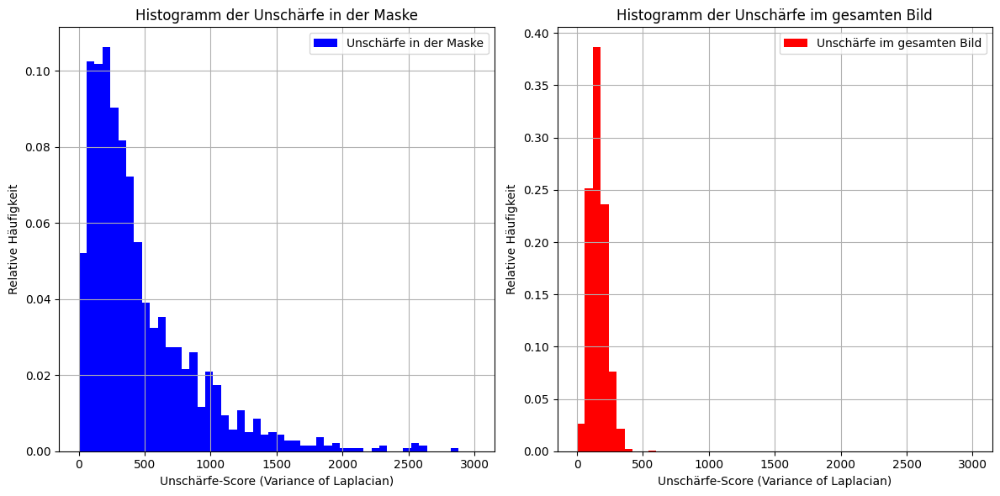

In [23]:
plt.figure(figsize=(12, 6))

# Histogramm für Unschärfe in der Maske (relativ)
plt.subplot(1, 2, 1)
weights_masked = np.ones_like(blur_scores_masked) / len(blur_scores_masked)
plt.hist(blur_scores_masked, bins=50, range=(0, 3000), weights=weights_masked, color='blue', label='Unschärfe in der Maske')
plt.xlabel('Unschärfe-Score (Variance of Laplacian)')
plt.ylabel('Relative Häufigkeit')
plt.title('Histogramm der Unschärfe in der Maske')
plt.legend()
plt.grid(True)

# Histogramm für Unschärfe im gesamten Bild (relativ)
plt.subplot(1, 2, 2)
weights_whole = np.ones_like(blur_scores_whole) / len(blur_scores_whole)
plt.hist(blur_scores_whole, bins=50, range=(0, 3000), weights=weights_whole, color='red', label='Unschärfe im gesamten Bild')
plt.xlabel('Unschärfe-Score (Variance of Laplacian)')
plt.ylabel('Relative Häufigkeit')
plt.title('Histogramm der Unschärfe im gesamten Bild')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

Diese Histogramm vergleichen die relative Häufigkeit der Unschärfe-Scores pro Pixel. Im linken Histogramm wurde für die Berechnung des Scores nur die Pixel der Erdrutsche verwendet, während rechts das gesamte Bild angeschaut wurde. Es wird ersichtlich, dass die Erdrutsche deutlich höhere Scores aufweisen können, verglichen mit den gesamten Bildern. Ein höherer Score bedeutet, dass Schärfe besser ist.

Ich vermute, dass die Schärfe bei Erdrutschen höher ist, als bei den Wälder, weil die Baumkronen meistens das gleiche Muster aufweisen und die Wälder deshalb eher als Fläche dargestellt werden. Bei Erdrutschen sind mehr Details zu erkennen, was vermutlich zu den höheren Scores führt.

## Rand-Intensitätsanalyse

Ich untersuche zuletzt auch die Ränder der Komponenten/Erdrutsche. Ich möchte dabei feststellen, ob ein Unterschied zum restlichen Bild festgestellt werden kann. Da die Ränder sehr dünn sind, bin ich vorerst noch skeptisch.

Ich lege keinen starken Wert auf diese Untersuchung, den der Code wurde mit viel Try/Error mit ChatGPT erstellt. Auch wenn das Resultat plausibel erscheint, besteht ein Risiko, weil ich nicht die einzelne Komponenten testen konnte. Trotzdem finde ich es eine interessante Untersuchung und führe sie durch. 

In [24]:
kernel = np.ones((3,3),np.uint8)

def get_inner_outer_edge_pixels(mask):
    dilation = cv2.dilate(mask, kernel, iterations=1)   # Erweitert die Ränder der Maske nach außen
    erosion = cv2.erode(mask, kernel, iterations=1)     # Verengt die Ränder der Maske nach innen
    
    inner_edge = mask - erosion         # Pixel knapp innerhalb der Ränder isolieren
    outer_edge = dilation - mask        # Pixel knapp außerhalb der Ränder isolieren
    
    return inner_edge, outer_edge


def calculate_edge_intensity(image, mask):
    # Identifizieren Sie die Komponenten in der Maske
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(mask)

    # Konvertieren Sie das Bild in Graustufen für die Intensitätsanalyse
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    edge_intensities = []
    component_intensities = []

    # Gehe durch alle identifizierten Komponenten
    for i in range(1, num_labels): # Starten Sie bei 1, um den Hintergrund zu überspringen
        # Erzeugen Sie eine Maske nur für die aktuelle Komponente
        component_mask = (labels == i).astype(np.uint8) * 255

        # Berechnen Sie die Intensität der gesamten Komponente
        component_intensity = np.mean(gray[component_mask == 255])
        component_intensities.append(component_intensity)

        # Finden Sie die Ränder der Komponente
        contours, _ = cv2.findContours(component_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Überprüfen Sie, ob Konturen gefunden wurden
        if not contours:
            continue

        for contour in contours:
            for point in contour:
                x, y = point[0]
                edge_intensities.append(gray[y, x])

    # Wenn keine Randintensitäten erfasst wurden, geben Sie None zurück
    if not edge_intensities:
        return None, None, None

    # Berechnen Sie die durchschnittliche Intensität und den Kontrast
    average_intensity = np.mean(edge_intensities)
    contrast = np.std(edge_intensities)
    average_component_intensity = np.mean(component_intensities)

    return average_intensity, contrast, average_component_intensity

intensity_values = []
contrast_values = []
component_intensities = []
differences = []

for images, masks in eda_train_loader:
    for image, mask_tensor in zip(images, masks):
        img = (image.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
        mask = mask_tensor.numpy().squeeze(0).astype(np.uint8)

        average_intensity, contrast, comp_intensity = calculate_edge_intensity(img, mask)
        
        # Überprüfen Sie, ob gültige Werte zurückgegeben wurden
        if average_intensity is not None and contrast is not None and comp_intensity is not None:
            intensity_values.append(average_intensity)
            contrast_values.append(contrast)
            component_intensities.append(comp_intensity)
        
                # Ränder isolieren
        inner_edge, outer_edge = get_inner_outer_edge_pixels(mask)

        # Pixelwerte an den isolierten Rändern extrahieren
        inner_edge_values = img[inner_edge == 1]
        outer_edge_values = img[outer_edge == 1]
        
        # Die Differenz der mittleren Werte berechnen
        if inner_edge_values.size > 0 and outer_edge_values.size > 0:
            diff = np.mean(inner_edge_values) - np.mean(outer_edge_values)
            differences.append(diff)

# Statistiken berechnen
average_intensity = np.mean(intensity_values) if intensity_values else None
average_contrast = np.mean(contrast_values) if contrast_values else None
average_comp_intensity = np.mean(component_intensities) if component_intensities else None
average_diff = np.mean(differences) if differences else None

print("Durchschnittliche Rand-Intensität:", round(average_intensity, 2) if average_intensity is not None else "N/A")
print("Durchschnittliche Intensität der Komponenten:", round(average_comp_intensity, 2) if average_comp_intensity is not None else "N/A")
print("Durchschnittliche Differenz der Intensität zwischen inneren und äußeren Rändern:", round(average_diff, 2) if average_diff is not None else "N/A")
print("Durchschnittlicher Kontrast an den Rändern:", round(average_contrast, 2) if average_contrast is not None else "N/A")

Durchschnittliche Rand-Intensität: 85.59
Durchschnittliche Intensität der Komponenten: 91.57
Durchschnittliche Differenz der Intensität zwischen inneren und äußeren Rändern: 21.65
Durchschnittlicher Kontrast an den Rändern: 20.1


Die Graustufen Intensität an den Rändern beträgt 85.6 und die Intensität der gesamten Komponenten 91.6. Die Differenz der Intensität von knapp innerhalb zu knapp ausserhalb der Ränder beträgt 21.6.

Ein Vergleich und Einschätzung folgt nach der Berechnung der Intensität des gesamten Bildes.

In [25]:
def calculate_image_intensity_and_contrast(image):
    # Konvertieren Sie das Bild in Graustufen für die Intensitätsanalyse
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Berechnen Sie die durchschnittliche Intensität und den Kontrast
    average_intensity = np.mean(gray)
    contrast = np.std(gray)

    return average_intensity, contrast

intensity_values = []
contrast_values = []

for images, _ in eda_train_loader:  # Sie benötigen keine Masken für diese Analyse
    for image in images:
        img = (image.permute(1, 2, 0).numpy() * 255).astype(np.uint8)

        average_intensity, contrast = calculate_image_intensity_and_contrast(img)
        intensity_values.append(average_intensity)
        contrast_values.append(contrast)

# Statistiken berechnen
average_intensity = np.mean(intensity_values)
average_contrast = np.mean(contrast_values)

print("Durchschnittliche Intensität:", round(average_intensity, 2))
print("Durchschnittlicher Kontrast:", round(average_contrast, 2))

Durchschnittliche Intensität: 54.8
Durchschnittlicher Kontrast: 14.27


Die Komponenten haben eine Intensität von 91.6, verglichen mit lediglich 54.8 über das gesamte Bild. Die Erdrutsche sind also deutlich heller, als die restlichen Teil des Bildes. Das bestätigt bereits getroffene Feststellungen. Da die Intensität an den Rändern der Erdrutsche um 21.6 steigt, deutet das darauf hin, dass die Ränder eine klar erkennbar Kante darstellen. Sollte dieses Resultat stimmen, gehe ich davon aus, dass auch die Modelle gut daran lernen können.

Zusätzlich habe ich den Kontrast vom gesamten Bild und den Komponenten berechnet. Dieser ist bei den Komponenten mit 20.1 merklich höher als beim gesamten Bild mit 14.3.

## Zusammenfassung von EDA

Die explorative Datenanalyse der Bilder hat interessante Erkenntnisse geliefert. Zum einen hat sich gezeigt, dass die Bilderqualität nicht sehr hoch ist. Auch sind die Erdrutsche relativ klein. Trotzdem unterscheiden sie sich vom Hintergrund in mehreren qualitativen Aspekten, wie Farbtöne, Kontrast, Schärfe und Intensität/Helligkeit. Ich gehe deshalb davon aus, dass trotz negativer Aspekte die Modelle die Erdrutsch lernen und segmentieren können.

# Vorbereitung der Codes fürs Training

In [7]:
device = "cuda" if torch.cuda.is_available() else "mps" if torch.backends.mps.is_available() else "cpu"
print(device)

cuda


In [8]:
def do_modeltrain(config, model, device, transform_train):
    
    train_data = SegmentationDataset(root='data', split='train', transform_mode=transform_train)
    train_loader = DataLoader(train_data, batch_size=config.batchsize, shuffle=True, num_workers = 10)

    test_data = SegmentationDataset(root='data', split='test', transform_mode='to_tensor')
    test_loader = DataLoader(test_data, batch_size=config.batchsize, shuffle=False, num_workers = 10)

    val_data = SegmentationDataset(root='data', split='validation', transform_mode='to_tensor')
    val_loader = DataLoader(val_data, batch_size=config.batchsize, shuffle=False, num_workers = 10)
    
    loss_fn = nn.BCEWithLogitsLoss(pos_weight=torch.tensor([weight_1]).to(device))
    optimizer = optim.Adam(model.parameters(), lr=config.learn_rate, weight_decay=config.l2_penalty)

    for t in range(config.epochs):
        train_loss, train_f1_background, train_f1_landslide= train_binary(train_loader, model, loss_fn, optimizer, device)
        test_loss, test_f1_background, test_f1_landslide = test_binary(test_loader, model, loss_fn, device)
        
        # Übermittlung der Daten an W&B
        wandb.log({"Train loss": train_loss, "Test loss": test_loss, "Train F1 Background": train_f1_background, "Train F1 Landslides": train_f1_landslide, "Test F1 Background": test_f1_background, "Test F1 Landslides": test_f1_landslide})
        print(t, "Train loss:", round(train_loss, 6), "Test loss:", round(test_loss, 6), "Train F1 Background:", round(train_f1_background, 6), "Train F1 Landslides:", round(train_f1_landslide, 6), "Test F1 Background:", round(test_f1_background, 6), "Test F1 Landslides:", round(test_f1_landslide, 6))

    val_loss, f1_val_background, f1_val_landslide = validation_binary(val_loader, model, loss_fn, device)
    wandb.log({"Val Loss": val_loss, "Val F1 Background": f1_val_background, "Val F1 Landslides": f1_val_landslide})

    print("Validation Loss: ", round(val_loss, 6), "Val F1 Background: ", round(f1_val_background, 6), "Val F1 Landslides: ", round(f1_val_landslide, 6))
    
    plot_samples_binary(train_loader, model, device, "Training")
    plot_samples_binary(val_loader, model, device, "Validation")
    
    wandb.config["Model Name"] = model.__class__.__name__ 

In [9]:
# Zähler für beide Klassen initialisieren
count_1 = 0
count_0 = 0

# Berechnen Sie die Pixelanzahl für beide Klassen
for _, masks in eda_train_loader:
    for mask in masks:
        count_1 += torch.sum(mask).item()
        count_0 += mask.numel() - torch.sum(mask).item()

# Gesamtzahl der Pixel
total_pixels = count_0 + count_1

# Gewichte für beide Klassen berechnen
weight_0 = count_0 / total_pixels
weight_1 = count_1 / total_pixels

print("Gewicht für Klasse 0 (Hintergrund):", weight_0)
print("Gewicht für Klasse 1 (Landslide):", weight_1)

Gewicht für Klasse 0 (Hintergrund): 0.9550122863549187
Gewicht für Klasse 1 (Landslide): 0.04498771364508123


# Baseline

Wie erwähnt handelt es sich beim Datensatz um eine Challenge [Landslide4Sense-2022](https://www.iarai.ac.at/landslide4sense/). Im Github Repo haben sie neben unzähligen Informationen und Anleitungen ein eigenes Baseline-Resultat veröffentlicht. Mit dem Validation Set haben mit U-Net einen F1 Score von 57.82 erzielt. Ich nehme deshalb dieses Resultat als mein Baseline und werde meine eigenen Modelle mit diesem Resultat vergleichen.

Bevor ich meine eigenen Modelle trainiere, habe ich das Model, das der Challenge-Owner zur Erstellung der Baseline verwendet hat, angeschaut:
- Bildergrösse = 128x128: Die originalen Bilder haben bereits diese Grösse und ich belasse diese unverändert.
- Anzahl Klassen = 2: Dies entspricht gemäss EDA auch meiner Anzahl Klassen.
- Batchsize = 32: Ich werde unterschiedliche Batchgrössen untersuchen.
- Learning Rate = 1e-2: Auch hier werde ich unterschiedliche Werte untersuchen. Da ich bei Versuchen festgestellt habe, dass 1e-2 auch ein guter Wert ist, werde ich mit diesem starten.
- Number Training steps = 5000: Ich verstehe nicht ganz, ob damit die Trainingsepochen gemeint ist. Aufgrund Resourcenbeschränkungen werde ich mit deutlich weniger Epochen, im tieferen zweistelligen Bereich, arbeiten.
- Weight Decay = 5e-4: Ich werde vorläufig keinen Penalty verwenden, ihn aber bei der Regularisierung untersuchen.
- Optimizer = Adam: Ich werde den selben Optimizer verwenden.
- Loss = CrossEntropyLoss: Auch hier verwende ich die selbe Metrik.

# Auswahl der Modelle

Ich habe mich entschieden, die Modelle FCN (Pytorch "fcn_resnet50") und Deeplabv3 (Pytorch deeplabv3_resnet50) zu verwenden. Es war mir dabei wichtig, Modelle möglichst gut vergleichen zu können. Ich habe mich deshalb für diese Modelle entschieden, weil sie von Pytorch implementiert wurden und den selben Output haben. Zu Beginn habe ich anstelle vom FCN mit U-Net gearbeitet, doch wurde dieses "extern" und für MRI Bilder implementiert. Neben dem unterschiedlichen Output und damit notwendigen doppelten Code, bereitete das U-Net Mühe bei Anpassungen, wie den Wechsel von Crossentropy Loss zur binären Crossentropy Loss. Obwohl ich nach den ersten Versuchen das Gefühl hatte, dass U-Net die kleinen Komponenten besser als Deeplabv3 lernen kann, habe ich mich schlussendlich gegen U-Net und für FCN entschieden.

Pretrained Weights: Ich werde die pretrained Weights von Pytorch verwenden. Für beide Modelle sind diese für den Datensatz VOC vorhanden. In Vergleichen beim Overfitting habe ich bei beiden Modellen festgestellt, dass mit diesen pretrained Weights die F1 Scores zu Beginn deutlich schneller steigen. Erst nach Abflachung der Steigung holt der Test ohne pretrained Weights langsam auf. Auch wenn ich länger als diesen optimalen Anzahl Epochen trainiere, behalte ich diese Weights bei, für den Fall, dass auch mal mit weniger Epochen trainiert werden soll. Weiter habe ich festgestellt, dass der Test Loss deutlich stabiler verläuft, wenn vortrainierte Gewichte verwendet werden.

# Overfit
Ich werde die Modelle U-Net und Deeplabv3 untersuchen. Beim U-Net bin ich insbesondere gespannt, ob und wie stark ich das Baseline der Challenge-Owner übertreffen kann.

## Overfit FCN

In [25]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Overfit FCN",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [80]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: 8z42navp
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20FCN/sweeps/8z42navp


wandb: Agent Starting Run: 0p1b2cjl with config:
wandb: 	batchsize: 64
wandb: 	epochs: 80
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.228274 Test loss: 0.052368 Train F1 Background: 0.953641 Train F1 Landslides: 0.037917 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
1 Train loss: 0.041177 Test loss: 0.02532 Train F1 Background: 0.976986 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
2 Train loss: 0.022806 Test loss: 0.018913 Train F1 Background: 0.976988 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
3 Train loss: 0.017409 Test loss: 0.016308 Train F1 Background: 0.976989 Train F1 Landslides: 0.0 Test F1 Background: 0.976332 Test F1 Landslides: 0.000756
4 Train loss: 0.01476 Test loss: 0.013256 Train F1 Background: 0.97699 Train F1 Landslides: 0.000233 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.013093 Test loss: 0.012031 Train F1 Background: 0.977045 Train F1 Landslides: 0.005096 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
6 Train loss: 0.012108 Test loss: 0.011465 Train F1 Background: 0.977139 Trai

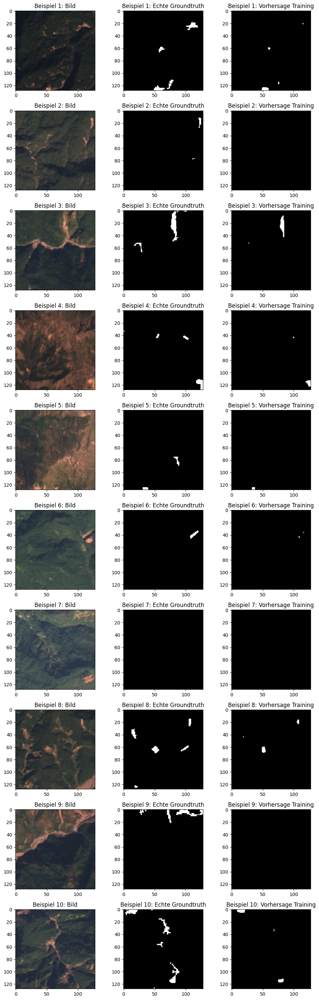

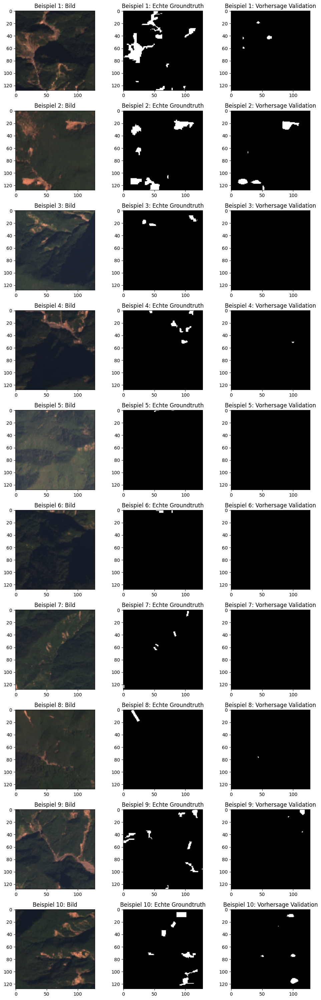

Test F1 Background,▁▁▁▁▂▁▃▆▄▅▄▇▆▅▄▄▆▆▆▆▅▆▇▅▆▅▄▅▇▅▇▇▆▇▇▇▆█▇█
Test F1 Landslides,▁▁▁▁▃▁▄▇▅▅▄▇▆▅▄▄▆▆▆▆▅▆▇▅▆▅▄▅▇▅▇▇▆▇▇█▆█▇█
Test loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇███████████████████████
Train F1 Landslides,▁▁▁▁▂▂▃▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇█▇█████████████
Train loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.98067
Test F1 Landslides,0.3568


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [26]:
sweep_overfit_fcn = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides FCN",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.fcn_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "to_tensor")

    torch.save(model.state_dict(), "weights/model_overfit_fcn.pth")

wandb.agent(sweep_overfit_fcn, function=main)
wandb.finish()

## Overfit Deeplabv3

In [27]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Overfit Deeplabv3",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [60]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: crgqnbf6
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20Deeplabv3/sweeps/crgqnbf6


wandb: Agent Starting Run: wadgzpch with config:
wandb: 	batchsize: 64
wandb: 	epochs: 60
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.335164 Test loss: 0.766798 Train F1 Background: 0.935582 Train F1 Landslides: 0.075614 Test F1 Background: 0.952308 Test F1 Landslides: 0.0461
1 Train loss: 0.096388 Test loss: 0.062911 Train F1 Background: 0.976958 Train F1 Landslides: 0.000131 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
2 Train loss: 0.048825 Test loss: 0.037525 Train F1 Background: 0.976981 Train F1 Landslides: 5.5e-05 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
3 Train loss: 0.03222 Test loss: 0.027332 Train F1 Background: 0.976989 Train F1 Landslides: 0.000188 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
4 Train loss: 0.024771 Test loss: 0.021697 Train F1 Background: 0.976991 Train F1 Landslides: 0.000229 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.020084 Test loss: 0.017272 Train F1 Background: 0.977067 Train F1 Landslides: 0.00781 Test F1 Background: 0.976433 Test F1 Landslides: 0.010912
6 Train loss: 0.017185 Test loss: 0.015659 Train F1 Backgro

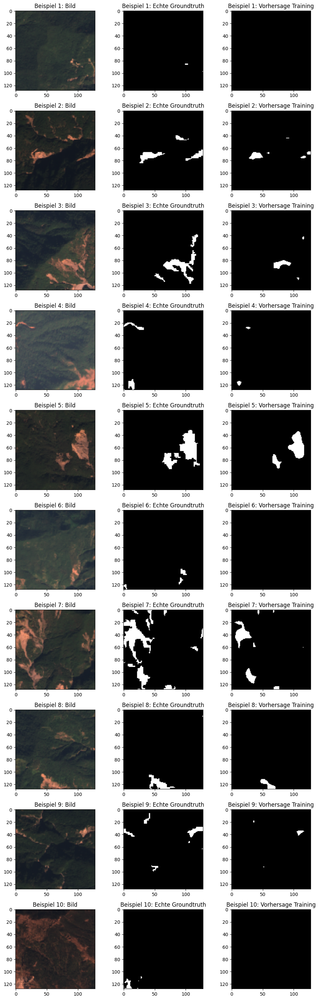

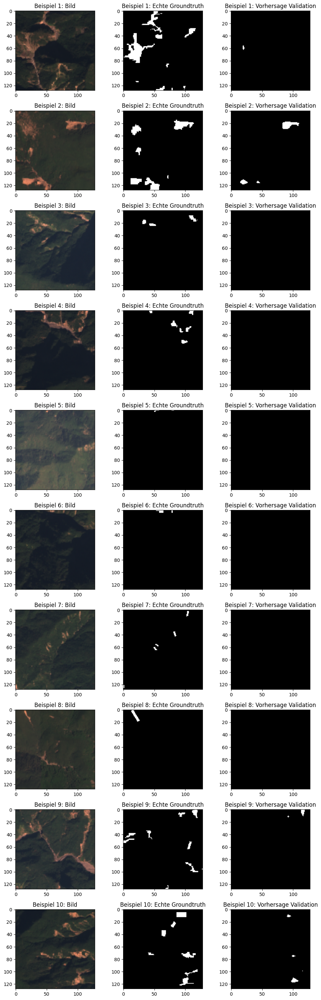

Test F1 Background,▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇██▇████████████████
Test F1 Landslides,▂▁▁▁▁▂▅▁▂▃▂▂▂▄▃▇▄▄▄▅▅▆▅▄▆▅▆▇▇▇▇▆▇▇▆█▆▇▆▇
Test loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█████████████████████
Train F1 Landslides,▂▁▁▁▁▁▂▂▂▃▃▃▃▄▄▅▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇████████
Train loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.97984
Test F1 Landslides,0.28846


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [28]:
sweep_overfit = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides Deeplabv3",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.deeplabv3_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(256, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "to_tensor")
    
    torch.save(model.state_dict(), "weights/model_overfit_deeplab2.pth")

wandb.agent(sweep_overfit, function=main)
wandb.finish()

# Regularize

## Normalization FCN

In [23]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Regularize Norm FCN",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [80]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: kwgvzx94
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20FCN/sweeps/kwgvzx94


wandb: Agent Starting Run: mjar0k4v with config:
wandb: 	batchsize: 64
wandb: 	epochs: 80
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.273962 Test loss: 0.056051 Train F1 Background: 0.92711 Train F1 Landslides: 0.066966 Test F1 Background: 0.976043 Test F1 Landslides: 6.6e-05
1 Train loss: 0.049221 Test loss: 0.027287 Train F1 Background: 0.976989 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
2 Train loss: 0.025142 Test loss: 0.020201 Train F1 Background: 0.976994 Train F1 Landslides: 0.000443 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
3 Train loss: 0.018558 Test loss: 0.016009 Train F1 Background: 0.977037 Train F1 Landslides: 0.004287 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
4 Train loss: 0.015554 Test loss: 0.013897 Train F1 Background: 0.977096 Train F1 Landslides: 0.00972 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.013771 Test loss: 0.012675 Train F1 Background: 0.977248 Train F1 Landslides: 0.023139 Test F1 Background: 0.976363 Test F1 Landslides: 0.004167
6 Train loss: 0.012568 Test loss: 0.011779 Train F1 Background

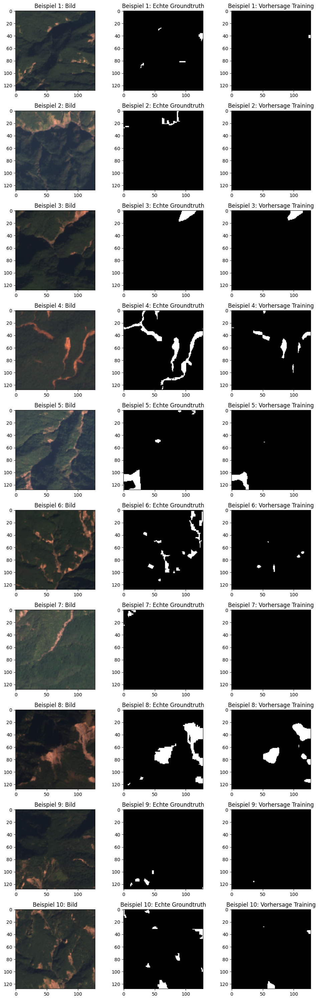

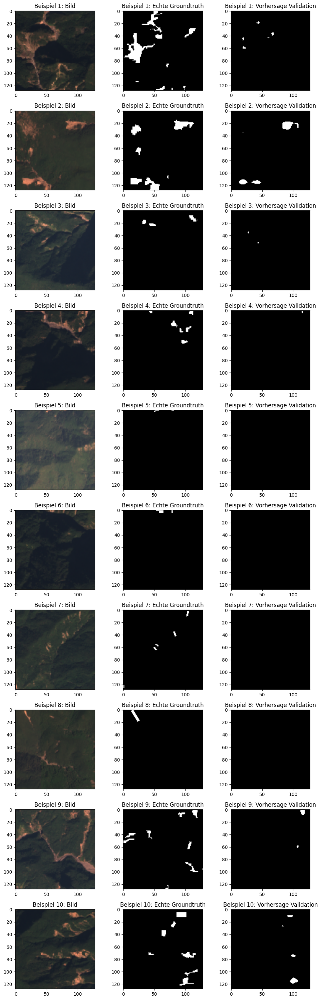

Test F1 Background,▁▁▁▂▃▂▅▃▃▅▅▅▆▅▅▆▅▅▆█▆█▇▇▆▅▇▇▇█▅▆▇▆▆▇▇▇▇▇
Test F1 Landslides,▁▁▁▁▂▁▅▃▃▅▅▅▆▅▅▆▅▅▆█▆█▇▇▆▅▇▇▇▇▅▆▇▆▆▇▇▇▇▇
Test loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁▇▇▇▇▇▇▇▇▇▇█████████████████████████████
Train F1 Landslides,▂▁▁▁▂▂▃▃▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█████████████
Train loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.97996
Test F1 Landslides,0.30779


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [24]:
sweep_regularize_norm_fcn = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides FCN",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.fcn_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "normalize")

    torch.save(model.state_dict(), "weights/model_regularize_norm_fcn.pth")

wandb.agent(sweep_regularize_norm_fcn, function=main)
wandb.finish()

## Normalization Deeplabv3

In [29]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Regularize Norm Deeplabv3",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [60]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: 6jr2pvtg
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20Deeplabv3/sweeps/6jr2pvtg


wandb: Agent Starting Run: 7isg352q with config:
wandb: 	batchsize: 64
wandb: 	epochs: 60
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.333644 Test loss: 0.160966 Train F1 Background: 0.936835 Train F1 Landslides: 0.119179 Test F1 Background: 0.976162 Test F1 Landslides: 0.000198
1 Train loss: 0.090312 Test loss: 0.075653 Train F1 Background: 0.976956 Train F1 Landslides: 7.8e-05 Test F1 Background: 0.972484 Test F1 Landslides: 0.001681
2 Train loss: 0.045883 Test loss: 0.038662 Train F1 Background: 0.976985 Train F1 Landslides: 0.0 Test F1 Background: 0.975631 Test F1 Landslides: 0.000528
3 Train loss: 0.030847 Test loss: 0.025725 Train F1 Background: 0.976987 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
4 Train loss: 0.023491 Test loss: 0.020898 Train F1 Background: 0.977023 Train F1 Landslides: 0.003073 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.019437 Test loss: 0.017161 Train F1 Background: 0.977039 Train F1 Landslides: 0.004611 Test F1 Background: 0.976326 Test F1 Landslides: 0.000239
6 Train loss: 0.016987 Test loss: 0.018146 Train F1 Bac

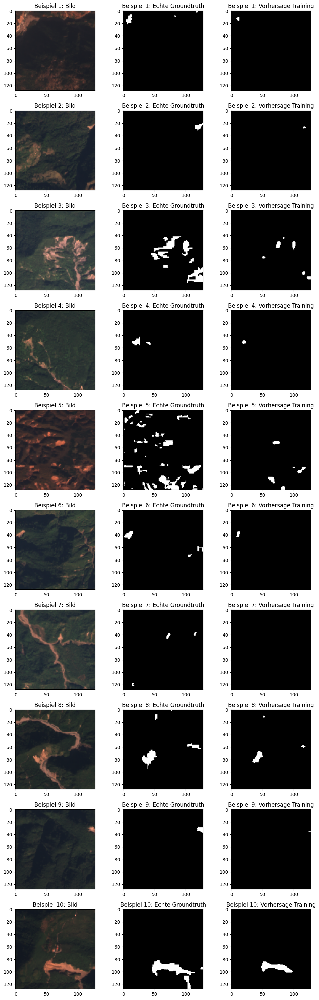

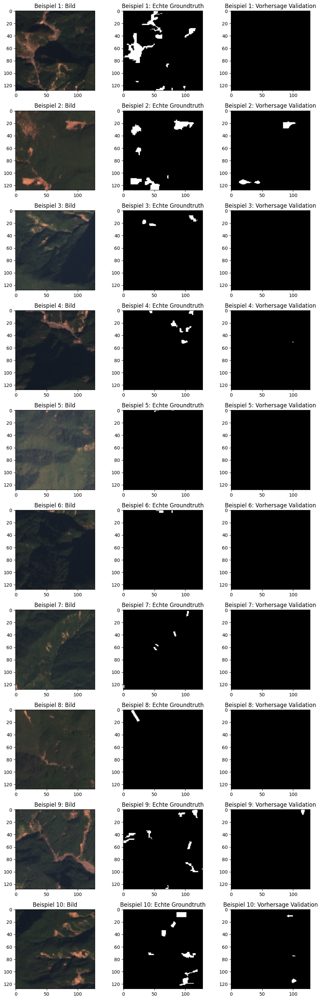

Test F1 Background,▄▁▄▄▄▅▄▄▅▆▅▆▅▅▆▅▆▇▆▆▇▆▇▇▇▇▇█▇▇▇▇▇▇▇█▇▇▇▇
Test F1 Landslides,▁▁▁▁▁▃▁▁▂▄▃▄▂▂▅▃▅▅▄▃▆▄▆▅▆▇▆█▇▆▆▇▆▇▆▇▇▇▇▇
Test loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████████
Train F1 Landslides,▃▁▁▁▁▁▂▂▂▂▂▃▃▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇████████
Train loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.9796
Test F1 Landslides,0.26665


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [30]:
sweep_regularize_norm = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides Deeplabv3",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.deeplabv3_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(256, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "normalize")

    torch.save(model.state_dict(), "weights/model_regularize_norm_deeplab2.pth")

wandb.agent(sweep_regularize_norm, function=main)
wandb.finish()

## Flip FCN

In [15]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Regularize Flip FCN",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [80]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: lhdw2jvn
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20FCN/sweeps/lhdw2jvn


wandb: Agent Starting Run: iqzb7fjc with config:
wandb: 	batchsize: 64
wandb: 	epochs: 80
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.25729 Test loss: 0.055482 Train F1 Background: 0.938109 Train F1 Landslides: 0.050259 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
1 Train loss: 0.043559 Test loss: 0.028375 Train F1 Background: 0.976989 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
2 Train loss: 0.02401 Test loss: 0.019789 Train F1 Background: 0.976989 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
3 Train loss: 0.01837 Test loss: 0.01609 Train F1 Background: 0.976997 Train F1 Landslides: 0.00073 Test F1 Background: 0.976328 Test F1 Landslides: 0.000424
4 Train loss: 0.015654 Test loss: 0.014137 Train F1 Background: 0.976997 Train F1 Landslides: 0.000736 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.014043 Test loss: 0.012801 Train F1 Background: 0.977041 Train F1 Landslides: 0.004691 Test F1 Background: 0.976431 Test F1 Landslides: 0.010872
6 Train loss: 0.012989 Test loss: 0.011947 Train F1 Background: 0.977

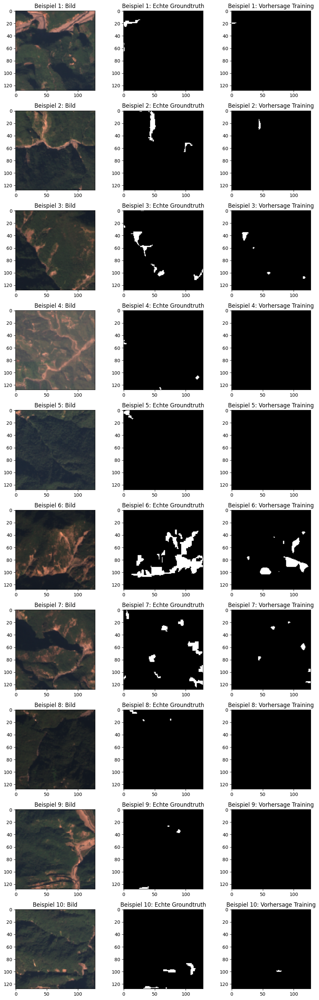

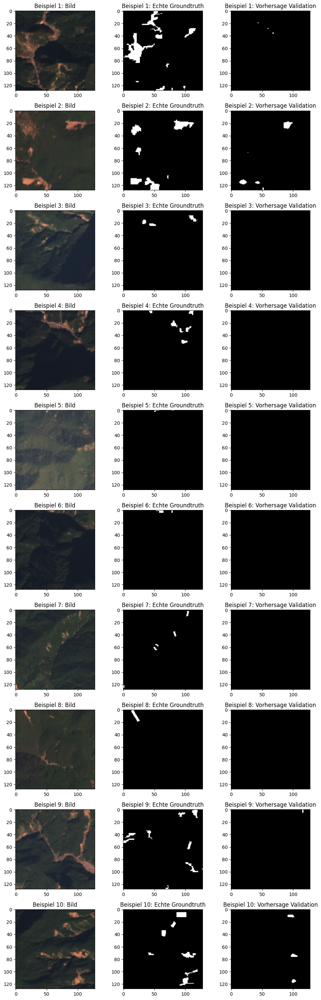

Test F1 Background,▁▁▁▁▁▂▂▁▁▃▂▄▂▄▅▃▄▅▅▆▆▇▇▆█▆▇▇▆▆▇▆██▆▇▆▇█▆
Test F1 Landslides,▁▁▁▁▁▂▂▁▁▄▂▄▂▄▅▄▄▅▅▆▆▇▇▆█▆▇▇▆▆▇▆██▆▇▆▇█▆
Test loss,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████████████████
Train F1 Landslides,▂▁▁▁▁▁▂▃▃▃▄▄▅▅▅▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇██████████
Train loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.97959
Test F1 Landslides,0.27004


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [16]:
sweep_regularize_flip_fcn = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides FCN",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.fcn_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "flip")

    torch.save(model.state_dict(), "weights/model_regularize_flip_fcn.pth")

wandb.agent(sweep_regularize_flip_fcn, function=main)
wandb.finish()

## Flip Deeplabv3

In [17]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Regularize Flip Deeplabv3",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [60]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: tk8ltgu1
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20Deeplabv3/sweeps/tk8ltgu1


wandb: Agent Starting Run: odqzy5mi with config:
wandb: 	batchsize: 64
wandb: 	epochs: 60
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.24403 Test loss: 0.171052 Train F1 Background: 0.973594 Train F1 Landslides: 0.027297 Test F1 Background: 0.955172 Test F1 Landslides: 0.015147
1 Train loss: 0.065091 Test loss: 0.048535 Train F1 Background: 0.976942 Train F1 Landslides: 0.0 Test F1 Background: 0.974574 Test F1 Landslides: 0.000964
2 Train loss: 0.035093 Test loss: 0.028472 Train F1 Background: 0.976981 Train F1 Landslides: 0.0 Test F1 Background: 0.976234 Test F1 Landslides: 0.0
3 Train loss: 0.024767 Test loss: 0.021444 Train F1 Background: 0.976988 Train F1 Landslides: 0.0 Test F1 Background: 0.976321 Test F1 Landslides: 0.0
4 Train loss: 0.020033 Test loss: 0.017527 Train F1 Background: 0.976992 Train F1 Landslides: 0.000304 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.01705 Test loss: 0.01455 Train F1 Background: 0.976992 Train F1 Landslides: 0.000298 Test F1 Background: 0.976371 Test F1 Landslides: 0.004405
6 Train loss: 0.015254 Test loss: 0.013472 Train F1 Background: 0.9

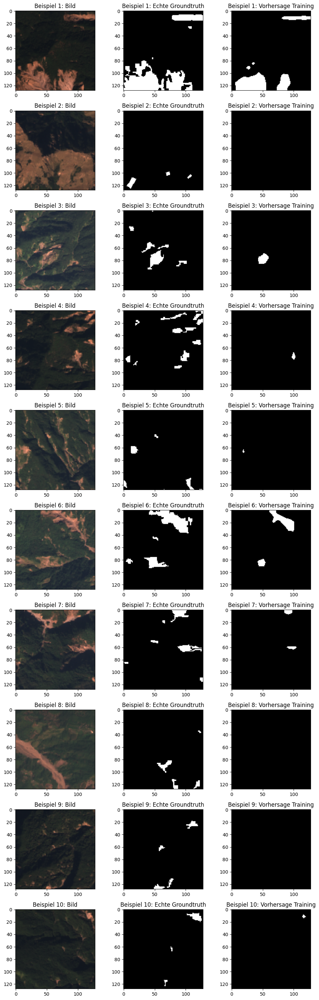

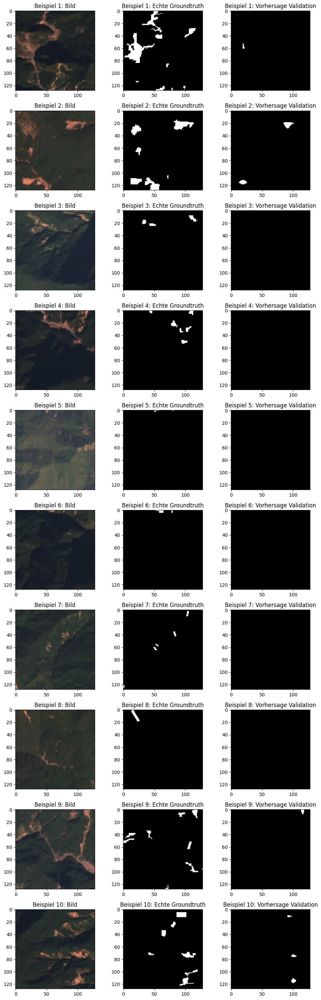

Test F1 Background,▁▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇▇█████▇████████
Test F1 Landslides,▁▁▁▁▁▁▁▁▂▂▂▃▃▅▄▃▁▄▄▃▄▃▂▃▃▂▅▆▅▇▇▄▆▆▇▇▆▇██
Test loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁▄▄▄▄▄▄▄▄▄▄▄▅▄▅▅▅▅▅▆▆▄▅▅▆▄▆▆▆▆▇▇▇▇▇█████
Train F1 Landslides,▁▁▁▁▁▁▁▁▂▂▂▂▃▃▃▄▄▃▄▅▅▂▃▃▅▃▅▅▆▆▆▇▆▇▇▇████
Train loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.97955
Test F1 Landslides,0.2641


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [18]:
sweep_regularize_flip = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides Deeplabv3",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.deeplabv3_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(256, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "flip")

    torch.save(model.state_dict(), "weights/model_regularize_flip_deeplab.pth")

wandb.agent(sweep_regularize_flip, function=main)
wandb.finish()

## L2 penalty FCN

In [19]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Regularize L2 FCN",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [80]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [1e-4]},
     }
}

Create sweep with ID: 2k1ljxjo
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20FCN/sweeps/2k1ljxjo


wandb: Agent Starting Run: hxp9kjrn with config:
wandb: 	batchsize: 64
wandb: 	epochs: 80
wandb: 	l2_penalty: 0.0001
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.26393 Test loss: 0.074113 Train F1 Background: 0.936949 Train F1 Landslides: 0.063718 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
1 Train loss: 0.044233 Test loss: 0.031429 Train F1 Background: 0.976988 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
2 Train loss: 0.023409 Test loss: 0.022545 Train F1 Background: 0.976989 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
3 Train loss: 0.017633 Test loss: 0.019168 Train F1 Background: 0.976989 Train F1 Landslides: 6.5e-05 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
4 Train loss: 0.015041 Test loss: 0.015807 Train F1 Background: 0.977021 Train F1 Landslides: 0.002919 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.013514 Test loss: 0.014572 Train F1 Background: 0.977052 Train F1 Landslides: 0.005749 Test F1 Background: 0.976327 Test F1 Landslides: 0.000742
6 Train loss: 0.0126 Test loss: 0.012774 Train F1 Background: 0.977132 

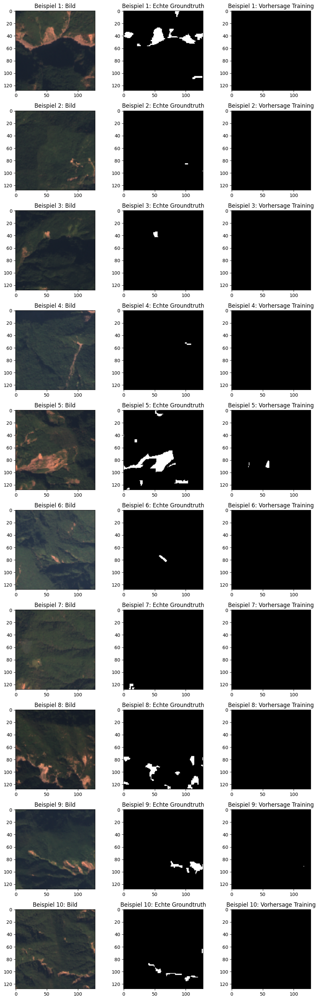

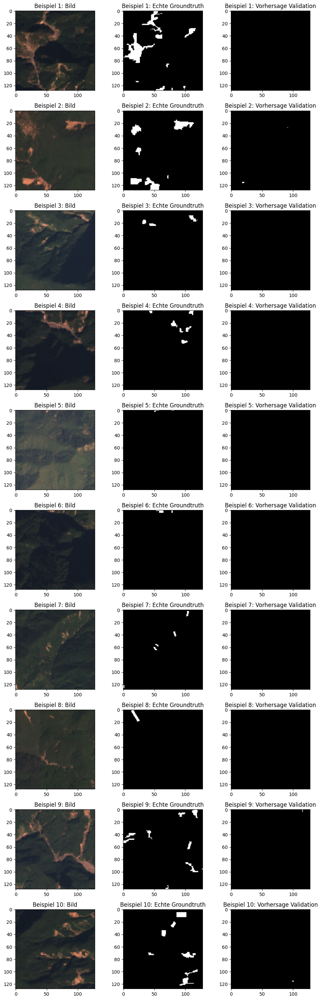

Test F1 Background,▁▁▁▁▁▁▁▂▂▂▂▂█▁▂▂▃▃▆▃▂▃▃▁▁▂▁▁▁▄▁▁▁▁▁▂▆▂▁▂
Test F1 Landslides,▁▁▁▁▁▁▁▂▂▂▂▂█▁▂▂▃▃▅▃▂▃▃▁▁▂▁▁▁▄▁▁▁▁▁▂▆▃▁▄
Test loss,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁███████████████████████████████████████
Train F1 Landslides,▃▁▁▁▂▂▃▄▄▅▃▅▅▄▆█▆▇▇▄▆█▇▂▁▂▂▂▂▄▃▃▄▅▃▅▄▄▄▂
Train loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.9768
Test F1 Landslides,0.07955


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [20]:
sweep_regularize_l2_fcn = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides FCN",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.fcn_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "flip")

    torch.save(model.state_dict(), "weights/model_regularize_l2_fcn.pth")

wandb.agent(sweep_regularize_l2_fcn, function=main)
wandb.finish()

## L2 penalty Deeplabv3

In [21]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Regularize L2 Deeplabv3",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [60]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [1e-4]},
     }
}

Create sweep with ID: oidcs9xm
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20Deeplabv3/sweeps/oidcs9xm


wandb: Agent Starting Run: pu3nhj0g with config:
wandb: 	batchsize: 64
wandb: 	epochs: 60
wandb: 	l2_penalty: 0.0001
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.31552 Test loss: 0.249006 Train F1 Background: 0.950223 Train F1 Landslides: 0.094732 Test F1 Background: 0.958954 Test F1 Landslides: 0.058889
1 Train loss: 0.082253 Test loss: 0.161755 Train F1 Background: 0.976989 Train F1 Landslides: 0.0 Test F1 Background: 0.962425 Test F1 Landslides: 0.030497
2 Train loss: 0.041696 Test loss: 0.030657 Train F1 Background: 0.976989 Train F1 Landslides: 2e-06 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
3 Train loss: 0.028219 Test loss: 0.023878 Train F1 Background: 0.976989 Train F1 Landslides: 8e-06 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
4 Train loss: 0.022244 Test loss: 0.020364 Train F1 Background: 0.976989 Train F1 Landslides: 2.5e-05 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
5 Train loss: 0.019443 Test loss: 0.296623 Train F1 Background: 0.976989 Train F1 Landslides: 5.7e-05 Test F1 Background: 0.954723 Test F1 Landslides: 0.04557
6 Train loss: 0.017045 Test loss: 0.016177 Train F1 Background: 

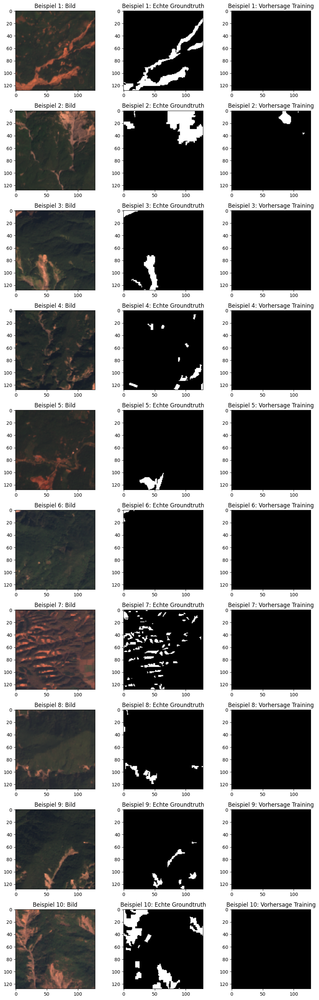

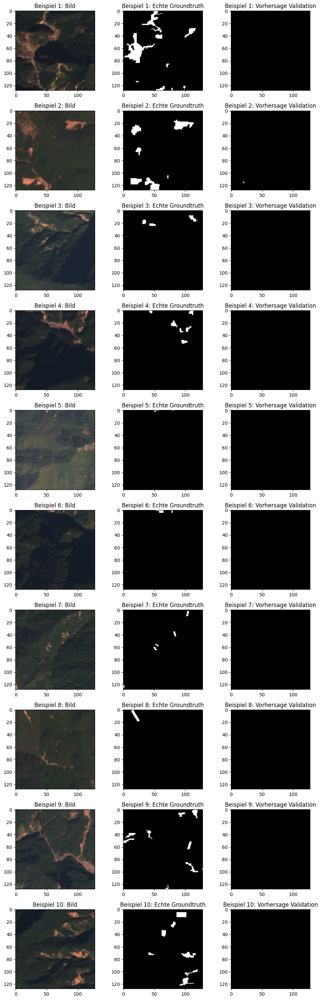

Test F1 Background,▁▂▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇█▇▇▇█▇▇▇▇▇▇▇▇█▇▇▇▇
Test F1 Landslides,▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▅▁▁▄▄▁▁▁▁▁▁▂▁▄▂▁▁▁
Test loss,█▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▆▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁███████████████████████████████████████
Train F1 Landslides,█▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▄▃▃▂▁▃▂▃▂▄▄▄▁▂▃▂▂▂▃▂▅▅▃▆
Train loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.97647
Test F1 Landslides,0.01399


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [22]:
sweep_regularize_l2 = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides Deeplabv3",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.deeplabv3_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(256, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "normalize")

    torch.save(model.state_dict(), "weights/model_regularize_l2_deeplab.pth")

wandb.agent(sweep_regularize_l2, function=main)
wandb.finish()

# Tune

## Tune FCN

In [16]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Tune FCN",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [80]},
        "learn_rate": {"values": [1e-3, 5e-4]},
        "batchsize": {"values": [32]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: 3dd93fgd
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20FCN/sweeps/3dd93fgd


wandb: Agent Starting Run: ey5jzz1q with config:
wandb: 	batchsize: 32
wandb: 	epochs: 80
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.157427 Test loss: 0.030113 Train F1 Background: 0.954864 Train F1 Landslides: 0.048515 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
1 Train loss: 0.021208 Test loss: 0.016517 Train F1 Background: 0.976989 Train F1 Landslides: 0.0 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
2 Train loss: 0.014811 Test loss: 0.013454 Train F1 Background: 0.97699 Train F1 Landslides: 0.000161 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
3 Train loss: 0.012508 Test loss: 0.012261 Train F1 Background: 0.977008 Train F1 Landslides: 0.00175 Test F1 Background: 0.976548 Test F1 Landslides: 0.019472
4 Train loss: 0.011304 Test loss: 0.011088 Train F1 Background: 0.977063 Train F1 Landslides: 0.00666 Test F1 Background: 0.976349 Test F1 Landslides: 0.002252
5 Train loss: 0.010643 Test loss: 0.010247 Train F1 Background: 0.977258 Train F1 Landslides: 0.024452 Test F1 Background: 0.976495 Test F1 Landslides: 0.015002
6 Train loss: 0.009959 Test loss: 0.010314 Train F1 Backg

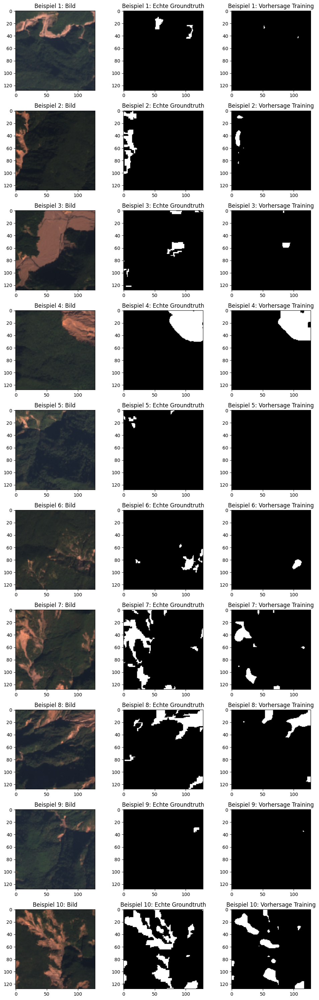

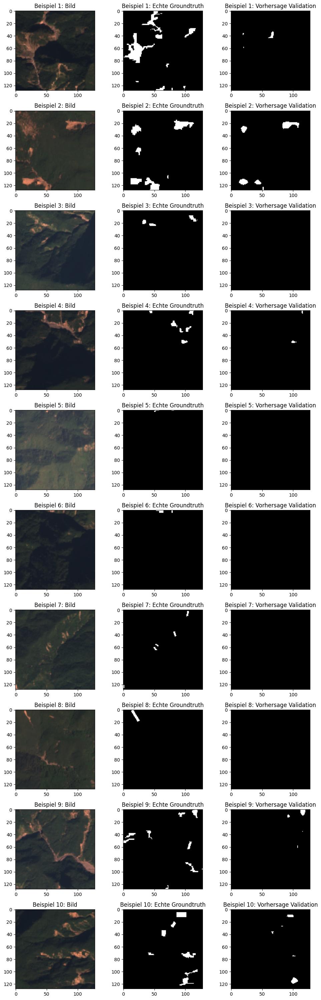

Test F1 Background,▁▁▁▃▂▁▅▅▆▅▅▆▅█▅▇▅▇▅▆▇▇▇▇▂▁▁▂▄▃▄▄█▇▇▇▆▇▅▇
Test F1 Landslides,▁▁▁▄▂▂▆▅▆▅▅▆▅█▆▇▅▇▅▆▇▇▇▇▂▁▁▂▄▄▄▄█▇█▇▆▇▅█
Test loss,█▂▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▂▂▂▁▂▁▁▁▁▁▁▁▁▂▂▂▂▂▂
Train F1 Background,▁▆▆▆▆▆▇▇▇▇▇▇████████████▇▆▆▆▆▇▇▇████████
Train F1 Landslides,▂▁▁▂▂▃▄▅▅▆▆▆▇▇▇▇▇▇▇█████▄▁▁▂▃▄▅▆▇▇▇█████
Train loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.98015
Test F1 Landslides,0.32039


wandb: Agent Starting Run: cpa4oqr3 with config:
wandb: 	batchsize: 32
wandb: 	epochs: 80
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.0005
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.208205 Test loss: 0.070739 Train F1 Background: 0.957753 Train F1 Landslides: 0.045609 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
1 Train loss: 0.048926 Test loss: 0.034845 Train F1 Background: 0.976978 Train F1 Landslides: 0.00036 Test F1 Background: 0.976326 Test F1 Landslides: 0.000199
2 Train loss: 0.026668 Test loss: 0.022862 Train F1 Background: 0.977019 Train F1 Landslides: 0.002852 Test F1 Background: 0.977158 Test F1 Landslides: 0.076389
3 Train loss: 0.019137 Test loss: 0.017136 Train F1 Background: 0.977178 Train F1 Landslides: 0.017956 Test F1 Background: 0.976586 Test F1 Landslides: 0.024559
4 Train loss: 0.015429 Test loss: 0.014476 Train F1 Background: 0.977492 Train F1 Landslides: 0.044611 Test F1 Background: 0.976445 Test F1 Landslides: 0.011348
5 Train loss: 0.013387 Test loss: 0.013037 Train F1 Background: 0.977687 Train F1 Landslides: 0.061119 Test F1 Background: 0.976765 Test F1 Landslides: 0.039565
6 Train loss: 0.012035 Test loss: 0.0121

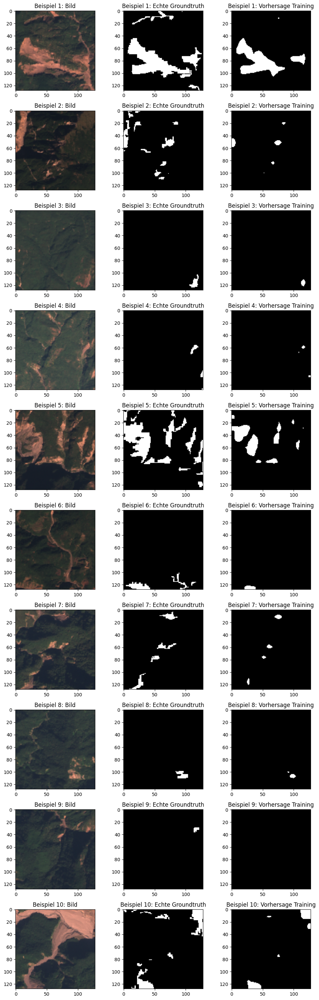

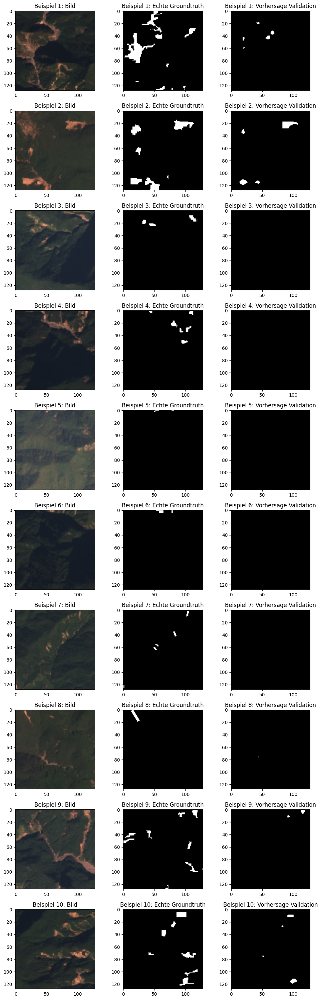

Test F1 Background,▁▃▁▂▅▄▄▄▄▅▅▅▆▆▆▂▅▆▇▆▇▇▇▆▆▇▇▇▇▇▇▆▇▇▅█▇▇▇▇
Test F1 Landslides,▁▃▁▃▅▄▄▄▄▅▅▅▆▆▆▂▅▆▇▆▇▇▇▆▆▇▇▇▇▇▇▆▇▇▅█▇▇▇▇
Test loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Train F1 Background,▁▆▆▆▆▆▇▇▇▇▇▇▇▇▇█▇▇██████████████████████
Train F1 Landslides,▂▁▁▂▃▄▄▅▅▆▆▆▆▇▇▇▆▇▇▇▇▇▇▇██████▇▇██▇▇████
Train loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.97961
Test F1 Landslides,0.27551


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [17]:
sweep_tune_fcn = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides FCN",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.fcn_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "to_tensor")

    filename = "weights/model_tuning_fcn_lr{}_bs{}.pth".format(config.learn_rate, config.batchsize)
    torch.save(model.state_dict(), filename)

wandb.agent(sweep_tune_fcn, function=main)
wandb.finish()

# Squeeze the Juice Out of It

## FCN

In [18]:
sweep_configuration = {
    "method": "grid",
    "name": "Semantische Segmentierung Train longer U-Net",
    "metric": {"goal": "minimize", "name": "Test loss"},
    "parameters": 
    {
        "epochs": {"values": [200]},
        "learn_rate": {"values": [1e-3]},
        "batchsize": {"values": [64]},
        "l2_penalty": {"values": [0]},
     }
}

Create sweep with ID: k3785vyj
Sweep URL: https://wandb.ai/patschue/DLBS%20Landslides%20FCN/sweeps/k3785vyj


wandb: Agent Starting Run: q2cca3lh with config:
wandb: 	batchsize: 64
wandb: 	epochs: 200
wandb: 	l2_penalty: 0
wandb: 	learn_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


0 Train loss: 0.233916 Test loss: 0.072342 Train F1 Background: 0.95224 Train F1 Landslides: 0.056902 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
1 Train loss: 0.041694 Test loss: 0.028791 Train F1 Background: 0.976983 Train F1 Landslides: 1.4e-05 Test F1 Background: 0.976325 Test F1 Landslides: 0.000159
2 Train loss: 0.022338 Test loss: 0.018497 Train F1 Background: 0.976999 Train F1 Landslides: 0.000993 Test F1 Background: 0.976326 Test F1 Landslides: 0.000278
3 Train loss: 0.016989 Test loss: 0.014957 Train F1 Background: 0.977029 Train F1 Landslides: 0.003612 Test F1 Background: 0.976323 Test F1 Landslides: 0.0
4 Train loss: 0.014508 Test loss: 0.013407 Train F1 Background: 0.977167 Train F1 Landslides: 0.015901 Test F1 Background: 0.976584 Test F1 Landslides: 0.02397
5 Train loss: 0.013027 Test loss: 0.012139 Train F1 Background: 0.977411 Train F1 Landslides: 0.038041 Test F1 Background: 0.976496 Test F1 Landslides: 0.016375
6 Train loss: 0.012055 Test loss: 0.011494 Trai

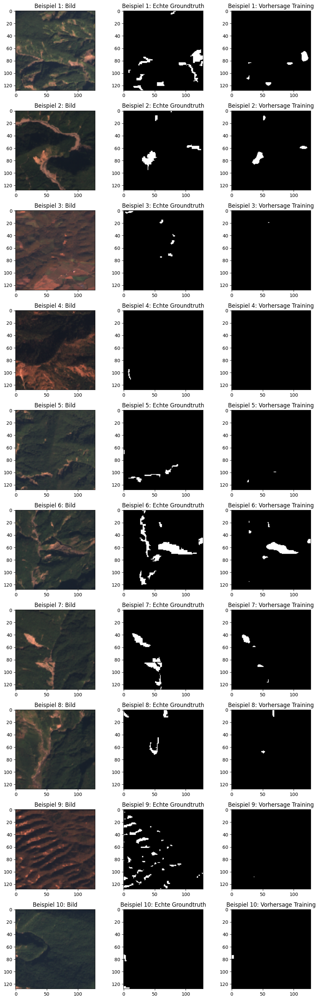

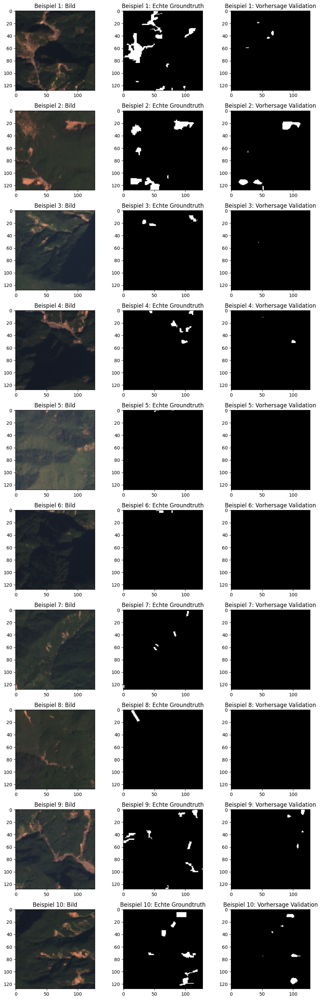

Test F1 Background,▁▁▃▃▄▆▅▆▆▆█▇▇▇▇██▇▇▇▇▇▅▁▁▄▅▆▇▆▇▆▇██▇▇█▇█
Test F1 Landslides,▁▁▃▃▄▆▅▆▆▆█▇▇▇▇▇█▇▇▇▇▇▆▁▁▄▅▆▇▆▇▆▇██▇▇█▇█
Test loss,█▂▁▁▁▁▁▁▂▂▂▂▂▂▂▂▃▂▂▂▂▃▂▁▁▁▁▁▂▂▂▂▂▃▂▂▂▃▂▂
Train F1 Background,▁▁▂▄▅▅▆▆▇▇▇▇▇▇▇▇▇██████▁▂▄▆▆▇▇▇█████████
Train F1 Landslides,▁▁▃▄▅▆▆▇▇▇▇▇▇██████████▁▂▅▆▇▇▇██████████
Train loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Val F1 Background,▁
Val F1 Landslides,▁
Val Loss,▁
Test F1 Background,0.98063
Test F1 Landslides,0.35861


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [19]:
sweep_trainlonger_fcn = wandb.sweep(sweep=sweep_configuration, project="DLBS Landslides FCN",  entity='patschue')

def main():
    run = wandb.init()

    config = run.config

    model = torchvision.models.segmentation.fcn_resnet50(weights='DEFAULT')
    model.classifier[4] = nn.Conv2d(512, 1, kernel_size=(1, 1), stride=(1, 1))
    model.to(device);

    do_modeltrain(config, model, device, transform_train = "to_tensor")

    torch.save(model.state_dict(), "weights/model_trainlonger_fcn.pth")

wandb.agent(sweep_trainlonger_fcn, function=main)
wandb.finish()